# Hyperspectral Crop Exploratory Data Analysis

## About
The purpose of this notebook is to analyze data collected by GHISACONUS (Global Hyperspectral Library of Agricultural Crops for Conterminous United States).  I will utilize a variety of interactive visualizations to look at the data distribution as well as the spectrum signatures for a variety of crops and growth stages.

## Import Libraries

In [52]:
import geopandas as gpd
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import plotly
import plotly.express as px
import plotly.graph_objects as go
import re
import scipy
import sklearn

from pandas.api.types import CategoricalDtype
from tqdm.notebook import tqdm

import warnings
warnings.filterwarnings("ignore")

## Read Data

In [40]:
dataset_path = '../data/raw/Hyperspectral_Crop_Data.csv'

dataset = pd.read_csv(dataset_path)
print("Data has \033[1m{} rows\033[0m and \033[1m{} columns.\033[0m \n".format(dataset.shape[0], dataset.shape[1]))
print(f"\n\033[1mThere are {dataset.duplicated().sum()} rows of duplicated values.\033[0m\n")

# Look at data summary and the head rows
print('''\n\033[1mOverall data summary below.  Note that 120 columns of spectrum data not summarized due to space limitations.\n
Columns not shown all follow the format of X###.  Where the number after X is the spectrum wavelength in nanometres(nm).\033[0m''')
desc = dataset.describe(include='all').T
desc['null'] = dataset.isna().sum()
desc['type'] = dataset.dtypes
desc['unique'] = dataset.nunique()
display(desc.iloc[0:20])

print("\n\033[1mFirst 5 rows of data below\033[0m")
display(dataset.head())

Data has 6988 rows and 142 columns. 


There are 0 rows of duplicated values.


Overall data summary below.  Note that 120 columns of spectrum data not summarized due to space limitations.

Columns not shown all follow the format of X###.  Where the number after X is the spectrum wavelength in nanometres(nm).


,count,unique,top,freq,mean,std,min,25%,50%,75%,max,null,type
UniqueID,6988.0,6988,NaN,NaN,8349.21494,3355.883373,1466.0,5439.75,8670.0,11231.5,13433.0,0,int64
Country,6988,1,USA,6988,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,object
AEZ,6988.0,7,NaN,NaN,8.076417,1.967504,2.0,6.0,9.0,10.0,10.0,0,int64
Image,6988,99,EO1H0280342010245110P3_SGS_01,675,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,object
Month,6988.0,6,NaN,NaN,7.766171,1.406497,5.0,7.0,8.0,9.0,10.0,0,int64
Year,6988.0,8,NaN,NaN,2012.596308,1.660552,2008.0,2012.0,2013.0,2014.0,2015.0,0,int64
jd,6988.0,78,NaN,NaN,219.47095,43.373447,123.0,184.0,225.0,253.0,302.0,0,int64
long,6988.0,1863,NaN,NaN,-94.935002,6.655487,-121.757011,-97.179724,-96.751871,-88.366985,-88.085632,0,float64
lat,6988.0,1983,NaN,NaN,39.079023,4.064115,31.666002,36.769552,39.738262,40.44956,45.724274,0,float64
Crop,6988,5,corn,2622,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,object



First 5 rows of data below


,UniqueID,Country,AEZ,Image,Month,Year,jd,long,lat,Crop,...,X2254,X2264,X2274,X2285,X2295,X2305,X2315,X2325,X2335,X2345
0,1466,USA,7,EO1H0440332012234110KD_SGS_01,8,2012,234,-121.663419,38.534516,corn,...,8.432855,8.438398,8.585301,8.164735,7.882625,7.380592,7.327904,6.881876,6.616288,6.346634
1,1467,USA,7,EO1H0440332012234110KD_SGS_01,8,2012,234,-121.671589,38.504744,corn,...,8.682515,8.942595,9.179517,8.744633,8.510454,8.090403,7.894839,7.263033,6.536649,5.663291
2,1469,USA,7,EO1H0440332012234110KD_SGS_01,8,2012,234,-121.597588,38.614056,corn,...,6.841276,6.276240,6.150597,6.114164,5.934033,5.116303,4.833205,4.817732,4.652525,3.790456
3,1470,USA,7,EO1H0440332012234110KD_SGS_01,8,2012,234,-121.687293,38.571702,corn,...,6.679967,6.534779,6.430438,6.080465,6.201545,6.291307,6.922908,6.943876,6.461839,5.696439
4,1476,USA,7,EO1H0440332012234110KD_SGS_01,8,2012,234,-121.625189,38.572225,rice,...,5.256362,5.022666,4.988447,5.220789,5.726055,6.007986,4.820400,3.084297,1.322807,1.087548


## Data Description

| Column | Description |
| :- | :- |
| **UniqueID** | Unique identifier per spectrum |
| **Country** | Country where image was taken |
| **AEZ** | Agroecological zones of the United States |
| **Image** | Which hyperspectral image the spectrum is from |
| **Month** | Month that image was taken |
| **Year** | Year that image was taken |
| **jd** |  |
| **long** | Longitude where image was taken |
| **lat** | Latitude where image was taken |
| **Crop** | Crop grown in image |
| **Stage** | Growth stage of crop when image was taken:<br>**Emerge VEarly** (Emergence/Very Early Vegetative)<br>**Early Mid** (Early and Mid Vegetative)<br>**Late** (Late Vegetative)<br>**Critical** (Critical)<br>**Mature Senesc** (Maturing/Senescence)<br>**Harvest** (Harvest) |
| **X###** | Spectrum reflective intensity.<br>Number after X represents wavelength of spectrum in nanometres (**nm**).<br>There are 131 different wavelengths in the dataset. |

## Data Visualization Preparation

In [41]:
# The Stage feature is categorical and follows a specific order.  We will cast the Stage variable to this ordered data type.
stage_sequence = CategoricalDtype(['Emerge_VEarly', 'Early_Mid', 'Late', 'Critical', 'Mature_Senesc', 'Harvest'], ordered=True)

dataset['Stage'] = dataset['Stage'].astype(stage_sequence)
dataset['Stage'].head()

0     Critical
1     Critical
2     Critical
3     Critical
4    Early_Mid
Name: Stage, dtype: category
Categories (6, object): ['Emerge_VEarly' < 'Early_Mid' < 'Late' < 'Critical' < 'Mature_Senesc' < 'Harvest']

In [42]:
# Isolate the wavelength columns and the specific wavelengths in nm
wave_cols = [c for c in dataset.columns if re.search('X\d+', c)]
print(wave_cols[0:5])
wave = np.array([int(x[1:]) for x in wave_cols])
print(wave[0:5])

['X437', 'X447', 'X457', 'X468', 'X478']
[437 447 457 468 478]


## Data Distribution

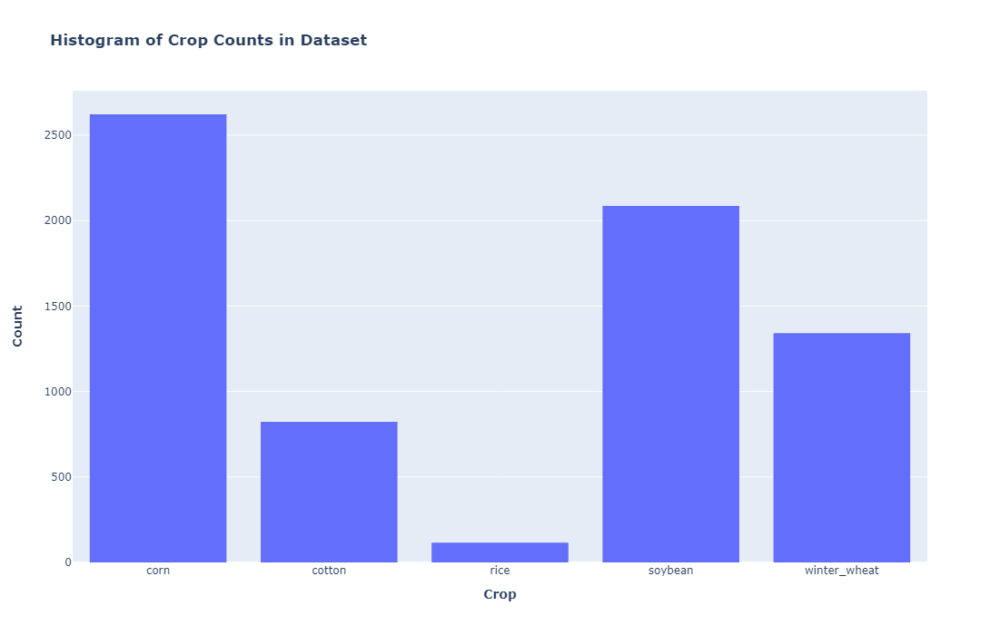

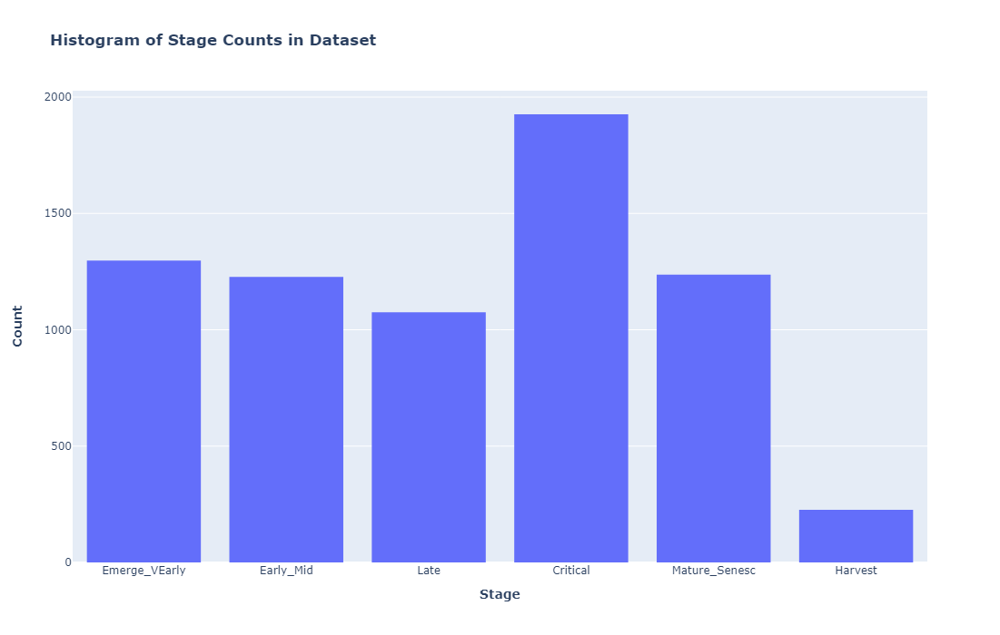

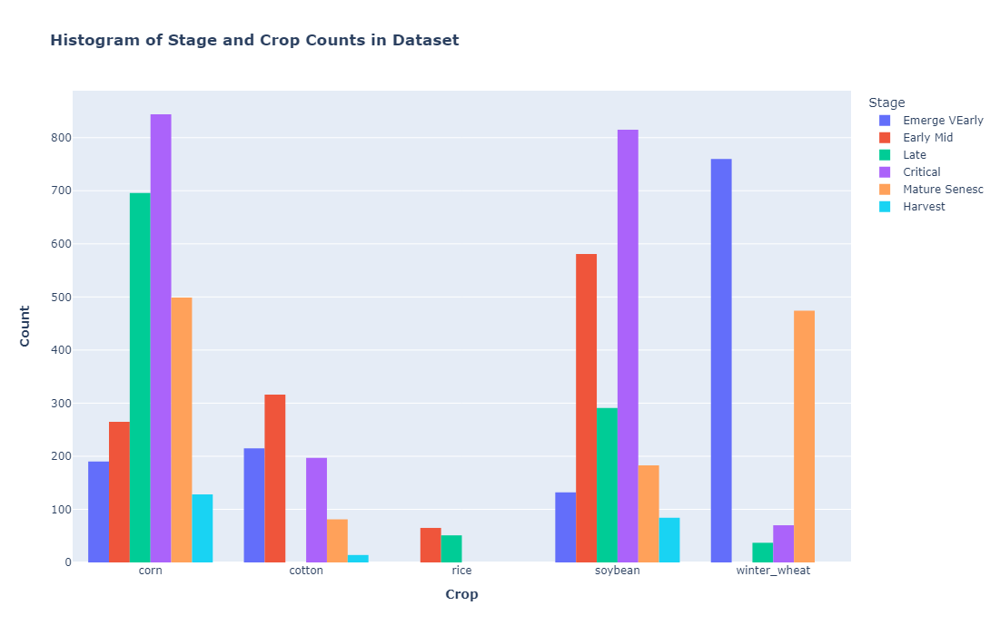

In [51]:
fig = px.histogram(dataset,
                   x="Crop",
                   title='<b>Histogram of Crop Counts in Dataset</b>',
                   category_orders={"Crop": ["corn", "cotton", "rice", "soybean", "winter_wheat"]})\
                  .update_layout(yaxis_title="<b>Count</b>", 
                                 xaxis_title="<b>Crop</b>",
                                 width=1000,
                                 height=700)
fig.show()

fig = px.histogram(dataset,
                   x="Stage",
                   title='<b>Histogram of Stage Counts in Dataset</b>',
                   category_orders={"Stage": ['Emerge_VEarly', 'Early_Mid', 'Late', 'Critical', 'Mature_Senesc', 'Harvest']})\
                  .update_layout(yaxis_title="<b>Count</b>",
                                 xaxis_title="<b>Stage</b>",
                                 width=1000,
                                 height=700)
fig.show()

fig = px.histogram(dataset,
                   x="Crop",
                   color="Stage",
                   barmode="group",
                   title='<b>Histogram of Stage and Crop Counts in Dataset</b>',
                   category_orders={"Crop": ["corn", "cotton", "rice", "soybean", "winter_wheat"],
                                    "Stage": ['Emerge_VEarly', 'Early_Mid', 'Late', 'Critical', 'Mature_Senesc', 'Harvest']})\
                  .update_layout(yaxis_title="<b>Count</b>",
                                 xaxis_title="<b>Crop</b>",
                                 width=1000,
                                 height=700)
fig.for_each_trace(lambda t: t.update(name=t.name.replace('_', ' ')))
fig.show()

### Analysis
We can see from the plots above that the dataset is quite unbalanced.  The crop with the most data is corn (2622 rows) and the crop with the least is rice (116 rows).  Additionally the stage data is also largely unbalanced.  There is the most data when crops are at the Critical stage (1926 rows) and the least when crops are at the Harvest stage (226 rows).

The combined distribution plot shows how the stage data is unbalanced within the same crop.  For example, most of the data for winter wheat occurs during the Emerge VEarly stage.  While for corn and soybeans, most of their data is taken while at the Critical stage.

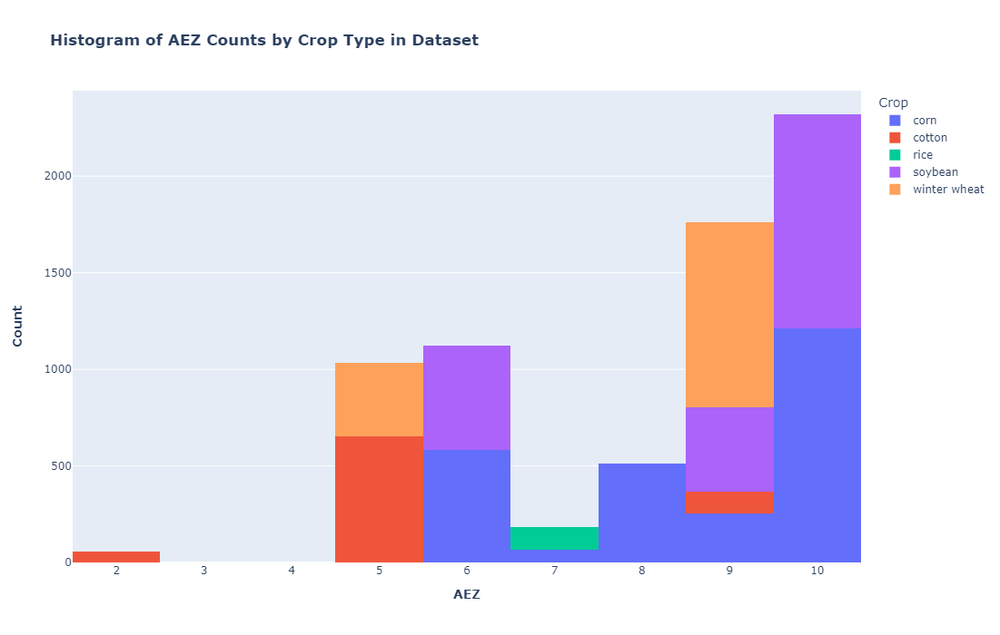

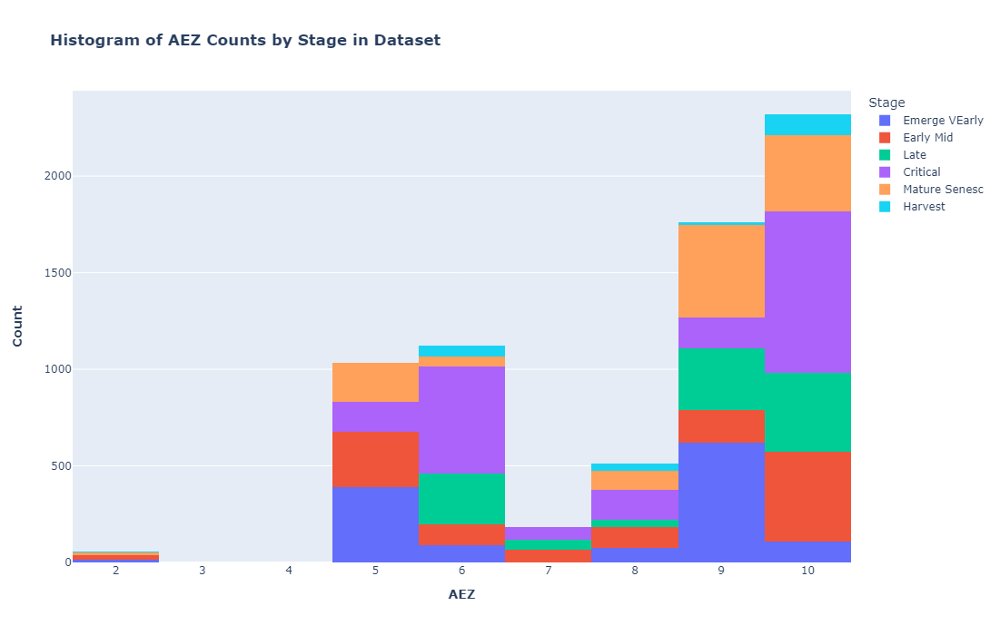

In [54]:
# Let's look at AEZ (Agroecological Zone) data next

fig = px.histogram(dataset,
                   x="AEZ",
                   color='Crop',
                   title='<b>Histogram of AEZ Counts by Crop Type in Dataset</b>',
                   category_orders={"Crop": ["corn", "cotton", "rice", "soybean", "winter_wheat"]})\
                  .update_layout(yaxis_title="<b>Count</b>", 
                                 xaxis_title="<b>AEZ</b>",
                                 width=1000,
                                 height=700)
fig.for_each_trace(lambda t: t.update(name=t.name.replace('_', ' ')))
fig.show()

fig = px.histogram(dataset,
                   x="AEZ",
                   color='Stage',
                   title='<b>Histogram of AEZ Counts by Stage in Dataset</b>',
                   category_orders={"Stage": ['Emerge_VEarly', 'Early_Mid', 'Late', 'Critical', 'Mature_Senesc', 'Harvest']})\
                  .update_layout(yaxis_title="<b>Count</b>",
                                 xaxis_title="<b>AEZ</b>",
                                 width=1000,
                                 height=700)
fig.for_each_trace(lambda t: t.update(name=t.name.replace('_', ' ')))
fig.show()

### Analysis
We can see from the above plots that most of our data is from zones 9 and 10.  Some other observations are that the only rice data we have is from zone 7.

The stage plot reveals that there is no Harvest data from zone 5 or 7.  While Zone 10 has the most data it has a relatively smaller proportion of Emerge VEarly data (109 rows out of a total of 2320 rows in the zone).

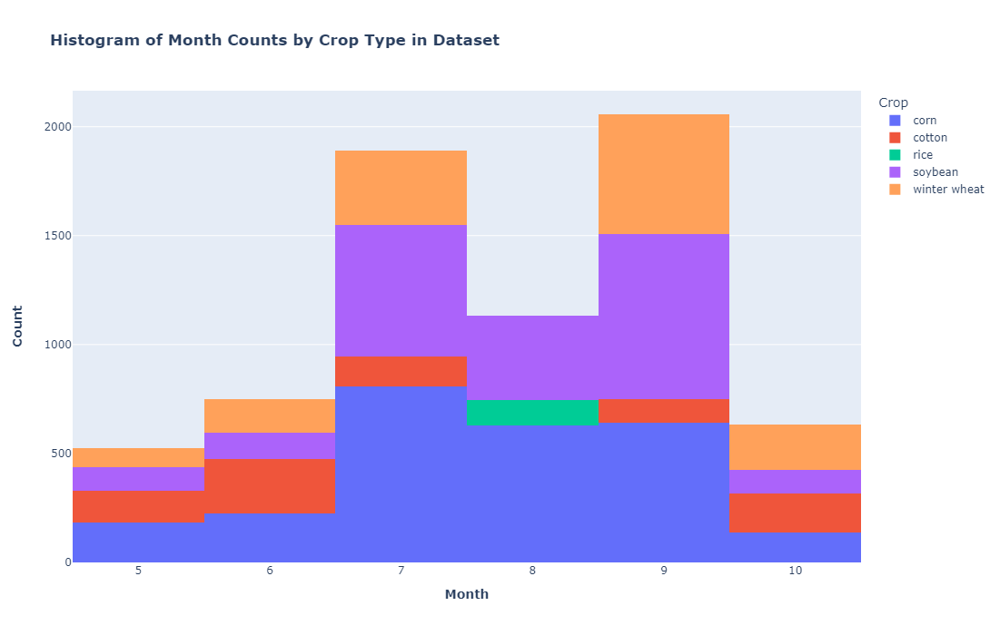

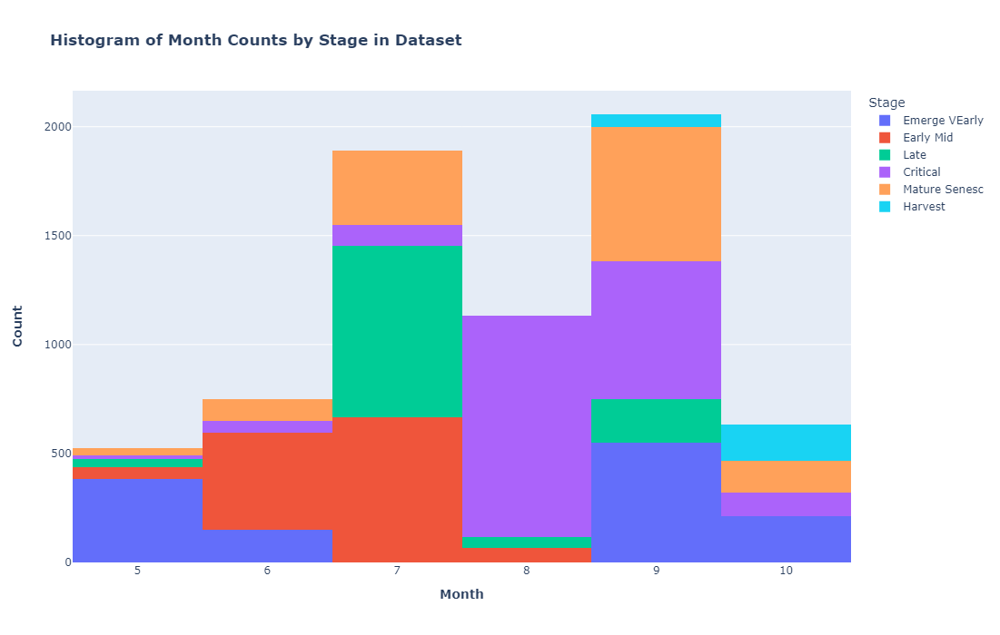

In [58]:
# Let's look at Month data next

fig = px.histogram(dataset,
                   x="Month",
                   color='Crop',
                   title='<b>Histogram of Month Counts by Crop Type in Dataset</b>',
                   category_orders={"Crop": ["corn", "cotton", "rice", "soybean", "winter_wheat"]})\
                  .update_layout(yaxis_title="<b>Count</b>", 
                                 xaxis_title="<b>Month</b>",
                                 width=1000,
                                 height=700)
fig.for_each_trace(lambda t: t.update(name=t.name.replace('_', ' ')))
fig.show()

fig = px.histogram(dataset,
                   x="Month",
                   color='Stage',
                   title='<b>Histogram of Month Counts by Stage in Dataset</b>',
                   category_orders={"Stage": ['Emerge_VEarly', 'Early_Mid', 'Late', 'Critical', 'Mature_Senesc', 'Harvest']})\
                  .update_layout(yaxis_title="<b>Count</b>",
                                 xaxis_title="<b>Month</b>",
                                 width=1000,
                                 height=700)
fig.for_each_trace(lambda t: t.update(name=t.name.replace('_', ' ')))
fig.show()

### Analysis
Most of the data is taken during the months of July or September.  Rice only has data during the month of August. This correlates with the earlier findings that rice only has data for the Early Mid and Late stages.  The other stages seem mostly spread out over the months with the Harvest stage found only during September and October as expected. 

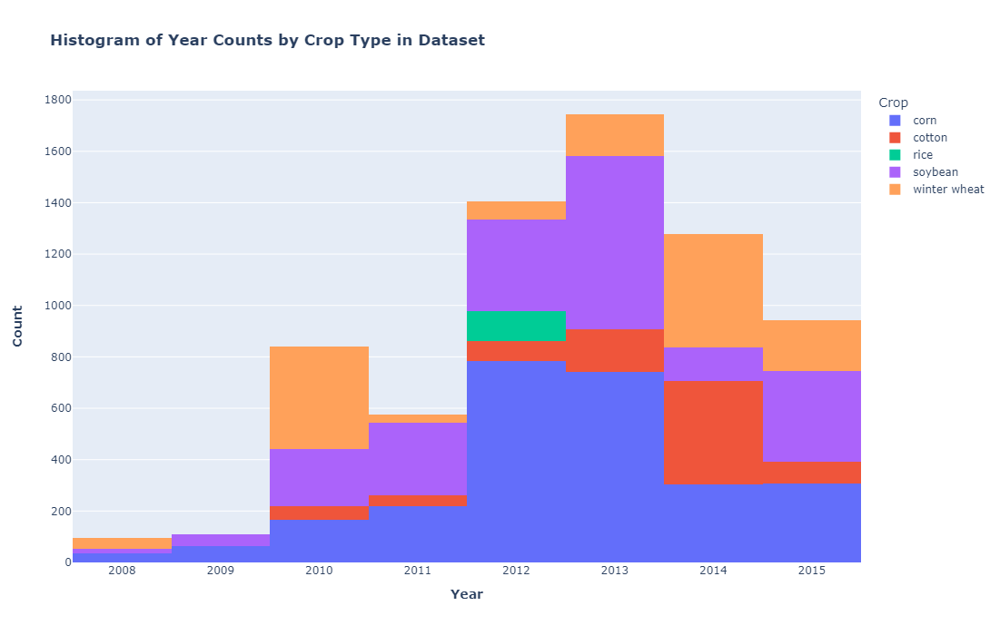

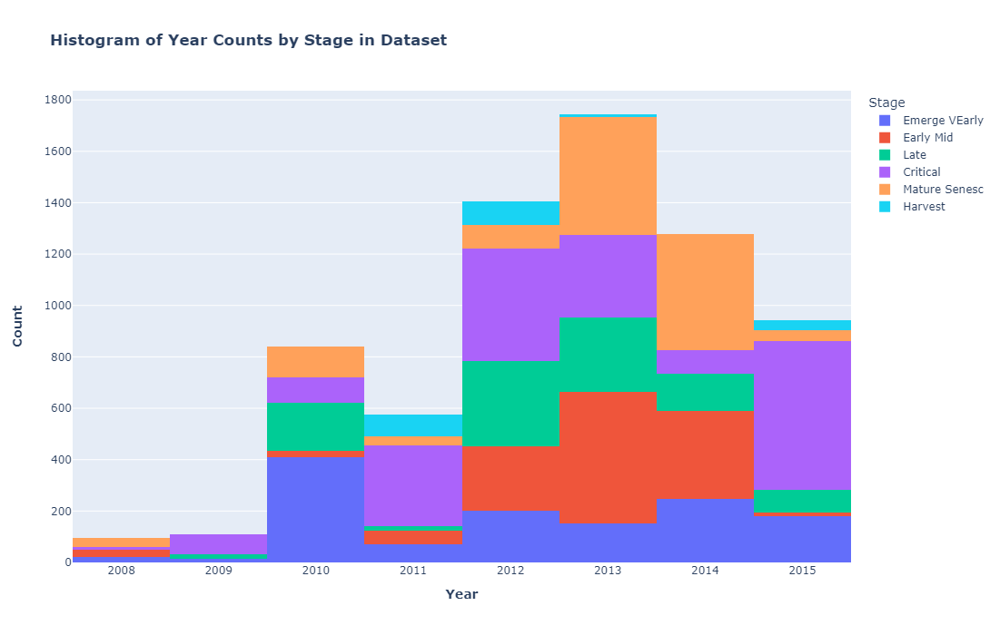

In [59]:
# Let's look at Year data next

fig = px.histogram(dataset,
                   x="Year",
                   color='Crop',
                   title='<b>Histogram of Year Counts by Crop Type in Dataset</b>',
                   category_orders={"Crop": ["corn", "cotton", "rice", "soybean", "winter_wheat"]})\
                  .update_layout(yaxis_title="<b>Count</b>", 
                                 xaxis_title="<b>Year</b>",
                                 width=1000,
                                 height=700)
fig.for_each_trace(lambda t: t.update(name=t.name.replace('_', ' ')))
fig.show()

fig = px.histogram(dataset,
                   x="Year",
                   color='Stage',
                   title='<b>Histogram of Year Counts by Stage in Dataset</b>',
                   category_orders={"Stage": ['Emerge_VEarly', 'Early_Mid', 'Late', 'Critical', 'Mature_Senesc', 'Harvest']})\
                  .update_layout(yaxis_title="<b>Count</b>",
                                 xaxis_title="<b>Year</b>",
                                 width=1000,
                                 height=700)
fig.for_each_trace(lambda t: t.update(name=t.name.replace('_', ' ')))
fig.show()

### Analysis
The yearly data breakdown indicates that the year with the most data is 2013 (1744 rows).  While the years 2008 and 2009 have much smaller amounts of data collected.  Some other noteworthy observations are that rice only has data during the year 2012 while the years 2008, 2009, 2010, and 2014 have no data during the Harvest stage of any crop.

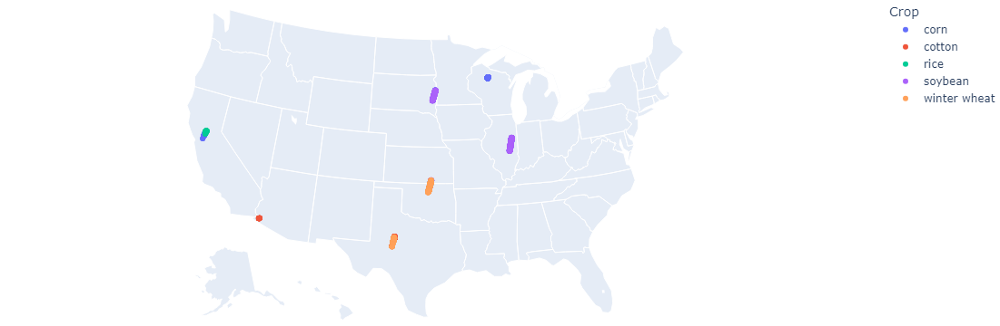

In [64]:
# Let's look at some geographic data next

fig = px.scatter_geo(
    data_frame=dataset,
    lat="lat",
    lon="long",
    color="Crop",
    locationmode="USA-states",
    category_orders={"Crop": ["corn", "cotton", "rice", "soybean", "winter_wheat"]})

fig.update_geos(scope='usa')
fig.for_each_trace(lambda t: t.update(name=t.name.replace('_', ' ')))
fig.update_layout(margin=dict(r=0, t=0, l=0, b=0))
fig.show()

### Analysis
Our data is mostly clustered together geographically in 7 different locations.  This matches with the earlier findings that there are 7 distinct AEZ zones in the dataset.  To get a better view of the different locations you need to zoom in on the map.  Corn can be found in all clusters except for Texas and Arizona.  Rice is only found in the cluster located in California.

To get a better view of these crop counts by state, we will create an interactive choropleth map next.

In [73]:
# Read in a polygon representation of the individual states and place in a geodataframe
gdf_states = gpd.read_file("https://www2.census.gov/geo/tiger/TIGER2021/STATE/tl_2021_us_state.zip")

gdf_states.head()


,REGION,DIVISION,STATEFP,STATENS,GEOID,STUSPS,NAME,LSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry
0,3,5,54,01779805,54,WV,West Virginia,00,G4000,A,62266298634,489204185,+38.6472854,-080.6183274,"POLYGON ((-80.85847 37.42831, -80.85856 37.428..."
1,3,5,12,00294478,12,FL,Florida,00,G4000,A,138961722096,45972570361,+28.3989775,-082.5143005,"MULTIPOLYGON (((-83.10874 24.62949, -83.10711 ..."
2,2,3,17,01779784,17,IL,Illinois,00,G4000,A,143778561906,6216493488,+40.1028754,-089.1526108,"POLYGON ((-89.17208 37.06831, -89.17296 37.067..."
3,2,4,27,00662849,27,MN,Minnesota,00,G4000,A,206232627084,18949394733,+46.3159573,-094.1996043,"POLYGON ((-92.74568 45.29604, -92.74629 45.295..."
4,3,5,24,01714934,24,MD,Maryland,00,G4000,A,25151992308,6979074857,+38.9466584,-076.6744939,"POLYGON ((-75.76659 39.37756, -75.76630 39.373..."


In [74]:
# Convert original dataset into a geodataframe with the same coordinate system as the US states shapefile
gdf_crops = gpd.GeoDataFrame(dataset,
                             geometry=gpd.points_from_xy(x=dataset['long'],
                                                         y=dataset['lat'],
                                                         crs=gdf_states.crs) # Coordinate Reference System
                            )

# Next perform a spatial join of the converted crops geodataframe and the US states dataframe
gdf_sjoin = gpd.sjoin(gdf_states, gdf_crops)

# Pivot table to aggregate observations by class type
for feature in ["Crop", "Stage"]:
    df_pivot = pd.pivot_table(gdf_sjoin, index="GEOID", columns=[feature], aggfunc={feature: len})
    df_pivot.columns = df_pivot.columns.droplevel()
    gdf_states = gdf_states.merge(df_pivot, how='left', on='GEOID')

gdf_states.head()

,REGION,DIVISION,STATEFP,STATENS,GEOID,STUSPS,NAME,LSAD,MTFCC,FUNCSTAT,...,cotton,rice,soybean,winter_wheat,Emerge_VEarly,Early_Mid,Late,Critical,Mature_Senesc,Harvest
0,3,5,54,01779805,54,WV,West Virginia,00,G4000,A,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,3,5,12,00294478,12,FL,Florida,00,G4000,A,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,3,17,01779784,17,IL,Illinois,00,G4000,A,...,NaN,NaN,1110.0,NaN,109.0,466.0,407.0,834.0,394.0,110.0
3,2,4,27,00662849,27,MN,Minnesota,00,G4000,A,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,3,5,24,01714934,24,MD,Maryland,00,G4000,A,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


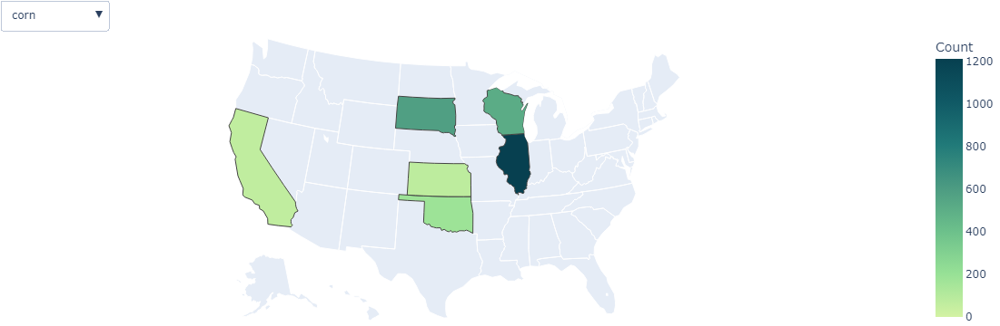

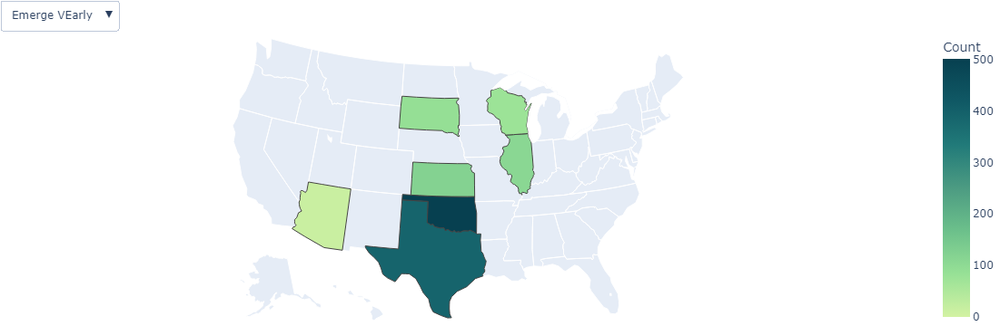

In [100]:
def get_traces_buttons(feature, categories):
    traces = []
    for i,c in enumerate(categories):
        trace = go.Choropleth(
            z=gdf_states[c],
            name="",
            locations=gdf_states["STUSPS"],
            locationmode="USA-states",
            colorscale="Emrld",
            colorbar_title="Count",
            zmin=0,
            zmax=(gdf_states[c].max() + 1)//1,
            visible = True if i == 0 else False)
        traces.append(trace)

    buttons = []
    for i,c in enumerate(categories):
        visible = [True if i==j else False for j,_ in enumerate(categories)]
        button = dict(
            label=c.replace("_", " "),
            method="update",
            args=[dict(visible=visible)]
        )
        buttons.append(button)
        
    return traces, buttons

def make_choropleth(feature, categories):
    traces, buttons = get_traces_buttons(feature, categories)
    fig = go.Figure()
    fig.add_traces(traces)
    fig.update_layout(
        geo_scope='usa', 
        margin=dict(r=0, t=0, l=0, b=0),
        updatemenus=[dict(
            type="dropdown",
            direction="down",
            buttons=buttons,
            x=0., xanchor="left",
            y=1.1, yanchor="top")]
    )
    return fig

categories = np.sort(dataset["Crop"].unique())
make_choropleth("Crop", categories).show()

categories = stage_sequence.categories
make_choropleth("Stage", categories).show()

### Analysis
The above choropleth maps combined with the dropdown buttons allow an easier view of the total counts across each state by crop and by growth stage.

## Spectrum Plots

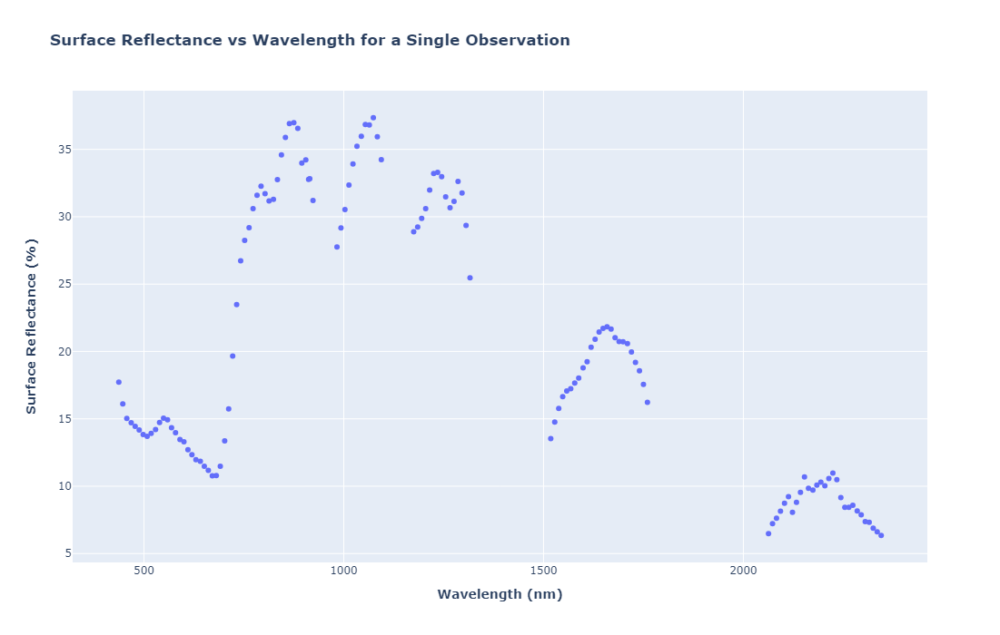

In [99]:
# Let's plot the spectrum signature for the first observation of the dataset
px.scatter(x=wave,
           y=dataset.loc[0,wave_cols],
           title="<b>Surface Reflectance vs Wavelength for a Single Observation</b>")\
          .update_layout(xaxis_title="<b>Wavelength (nm)</b>",
                         yaxis_title="<b>Surface Reflectance (%)</b>",
                         width=1000,
                         height=700)

## Analysis
There are some gaps in the wavelengths available because those wavelengths are known to be absorbed by water and therefore are not useful for crop identification analysis.

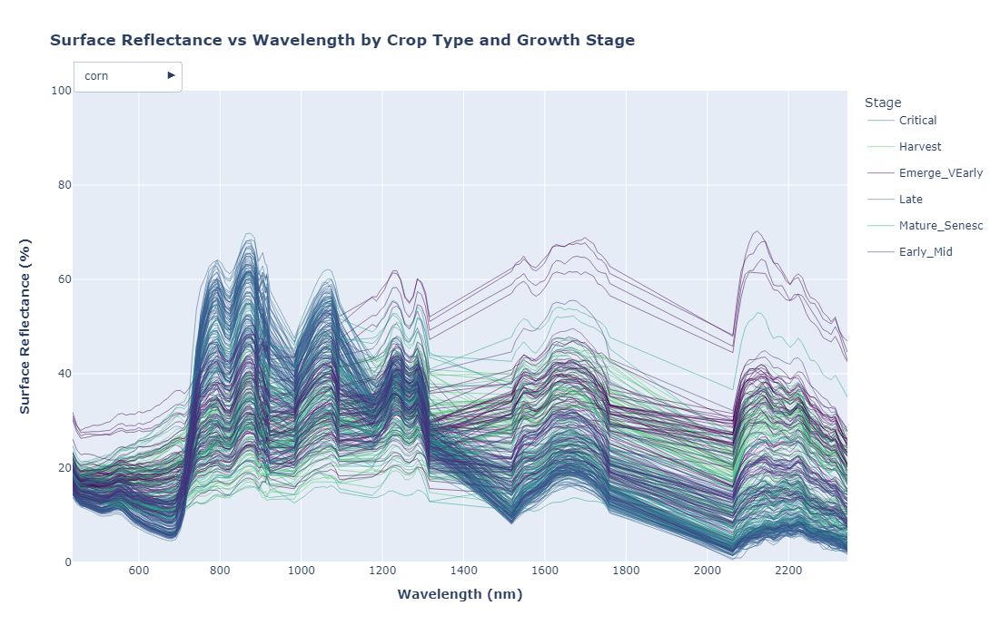

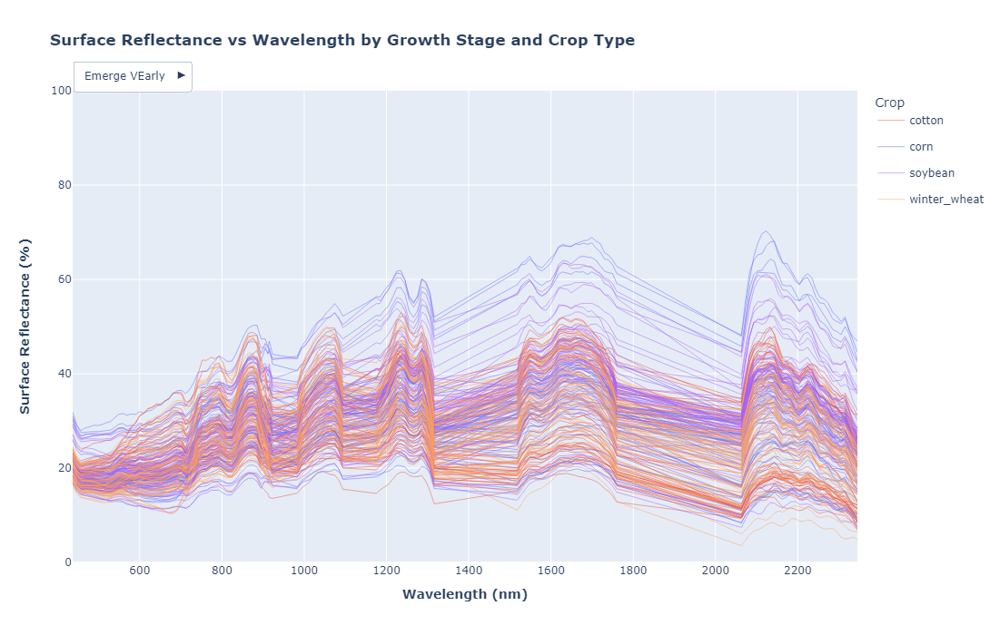

In [105]:
labels = {
    "Crop": np.sort(dataset["Crop"].unique()),
    "Stage": stage_sequence.categories
}

colors = {
    "Crop": {k:px.colors.qualitative.Plotly[i] for i,k in enumerate(labels["Crop"])},
    "Stage": {k:px.colors.sample_colorscale("viridis", i/(len(labels["Stage"])+1))[0] for i,k in enumerate(labels["Stage"])}
}

def make_line_plot(feature, title, n:int=50):
    feature2 = [l for l in labels.keys() if l != feature][0]
    buttons = {k:[] for k in labels[feature]}
    traces = []

    for i1, c1 in enumerate(labels[feature]):
        sub = dataset.query(f"{feature} == '{c1}'")
        
        for i2, c2 in enumerate(sub[feature2].unique()):
            sub2 = sub.query(f"{feature2} == '{c2}'")
            if n != None:
                sub2 = sub2.sample(frac=1, random_state=11 + 17*i1).reset_index(drop=True).iloc[:n]
            
            for ir, row in sub2.iterrows():
                trace = go.Scatter(
                    name=c2,
                    legendgroup=c2,
                    x=wave,
                    y=row[wave_cols],
                    line=dict(color=colors[feature2][c2], width=0.5),
                    showlegend=True if ir == 0 else False,
                    visible=True if i1==0 else False
                )
                traces.append(trace)
                
            # Add visibility to button
            vtrue = [True for _ in range(len(sub2))]
            vfalse = [False for _ in range(len(sub2))]
            for k,v in buttons.items():
                v.extend(vtrue if k==c1 else vfalse)

    buttons = [
        dict(
            label=k.replace("_", " "),
            method="update",
            args=[dict(visible=v)]
        )
        for k,v in buttons.items()
    ]

    fig = go.Figure()
    fig.add_traces(traces)
    fig.update_layout(
        updatemenus=[dict(
            type="dropdown",
            direction="right",
            buttons=buttons,
            x=0., xanchor="left",
            y=1, yanchor="bottom")
        ],
        yaxis_range=[0,100],
        title=title,
        xaxis_title="<b>Wavelength (nm)</b>",
        yaxis_title="<b>Surface Reflectance (%)</b>",
        legend_title=feature2,
        width=1000,
        height=700)
    return fig

make_line_plot("Crop", title="<b>Surface Reflectance vs Wavelength by Crop Type and Growth Stage</b>").show()
make_line_plot("Stage", title="<b>Surface Reflectance vs Wavelength by Growth Stage and Crop Type</b>").show()

## Analysis
Using the buttons above on the line plots it can be seen that the growth stages appear to have distinct wavelength signatures across the spectrum.  This illustrates why utilizing hyperspectrum data is effective at measuring crop growth.